This notebook focuses on trying to find a way to segment nuclei properly.
The end goals is to segment cell and extract morphology features from cellprofiler.
These masks must be imported into cellprofiler to extract features.

In [1]:
import argparse
import ast
import pathlib

import matplotlib.pyplot as plt

# Import dependencies
import numpy as np
import skimage
import tifffile
import torch
from cellpose import models
from csbdeep.utils import normalize
from PIL import Image
from stardist.plot import render_label

# check if in a jupyter notebook
try:
    cfg = get_ipython().config
    in_notebook = True
except NameError:
    in_notebook = False

if in_notebook:
    print("Running as a notebook")
elif not in_notebook:
    print("Running as script")

Running as a notebook


In [2]:
if not in_notebook:
    # set up arg parser
    parser = argparse.ArgumentParser(description="Segment the nuclei of a tiff image")

    parser.add_argument(
        "--input_dir",
        type=str,
        help="Path to the input directory containing the tiff images",
    )

    parser.add_argument(
        "--clip_limit",
        type=float,
        help="Clip limit for the adaptive histogram equalization",
    )
    parser.add_argument(
        "--optimize_segmentation",
        action="store_true",
        help="Optimize the segmentation parameters",
    )

    args = parser.parse_args()
    clip_limit = args.clip_limit
    input_dir = pathlib.Path(args.input_dir).resolve(strict=True)
    optimize_segmentation = args.optimize_segmentation
    print(optimize_segmentation)

else:
    input_dir = pathlib.Path(
        "../../2.illumination_correction/illum_directory/W0078_F0001"
    ).resolve(strict=True)
    clip_limit = 0.6
    optimize_segmentation = True


figures_dir = pathlib.Path("../figures").resolve()
figures_dir.mkdir(exist_ok=True, parents=True)

if optimize_segmentation:
    print("Optimizing Segmentation")
elif not optimize_segmentation:
    print("Running segmentation")

Optimizing Segmentation


In [3]:
# set up memory profiler for GPU
device = torch.device("cuda:0")
free_before, total_before = torch.cuda.mem_get_info(device)
starting_level_GPU_RAM = (total_before - free_before) / 1024**2
print("Starting level of GPU RAM available (MB): ", starting_level_GPU_RAM)

Starting level of GPU RAM available (MB):  19831.75


## Set up images, paths and functions

In [4]:
image_extensions = {".tif", ".tiff"}
files = sorted(input_dir.glob("*"))
files = [str(x) for x in files if x.suffix in image_extensions]

In [5]:
image_dict = {
    "nuclei_file_paths": [],
    "nuclei": [],
}

In [6]:
# split files by channel
for file in files:
    if "C4" in file.split("/")[-1]:
        image_dict["nuclei_file_paths"].append(file)
        image_dict["nuclei"].append(tifffile.imread(file).astype(np.float32))
nuclei_image_list = [np.array(nuclei) for nuclei in image_dict["nuclei"]]

nuclei = np.array(nuclei_image_list).astype(np.int16)

nuclei = skimage.exposure.equalize_adapthist(nuclei, clip_limit=clip_limit)

print(nuclei.shape)

(18, 2000, 2000)


In [7]:
original_nuclei_image = nuclei.copy()

## Cellpose

### optimization

resnet_torch.py (271): You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.


3


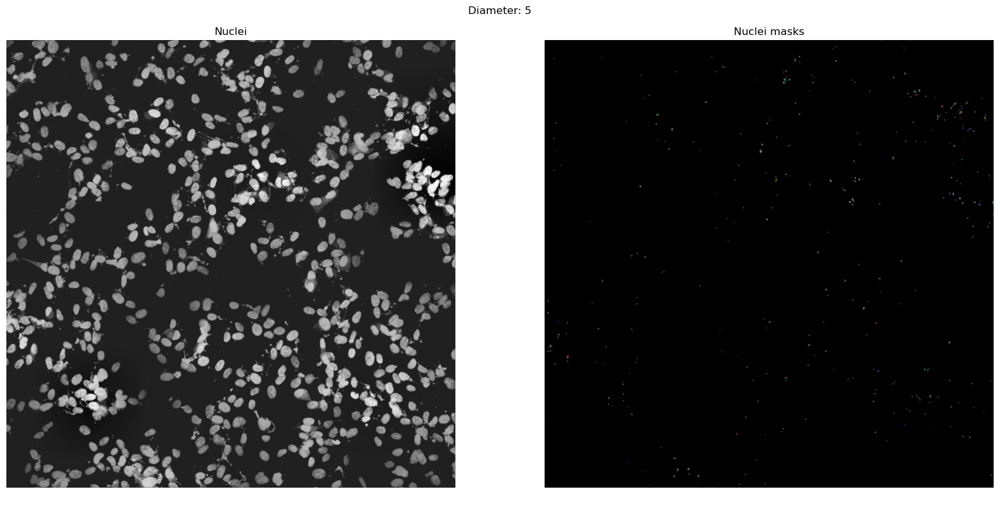

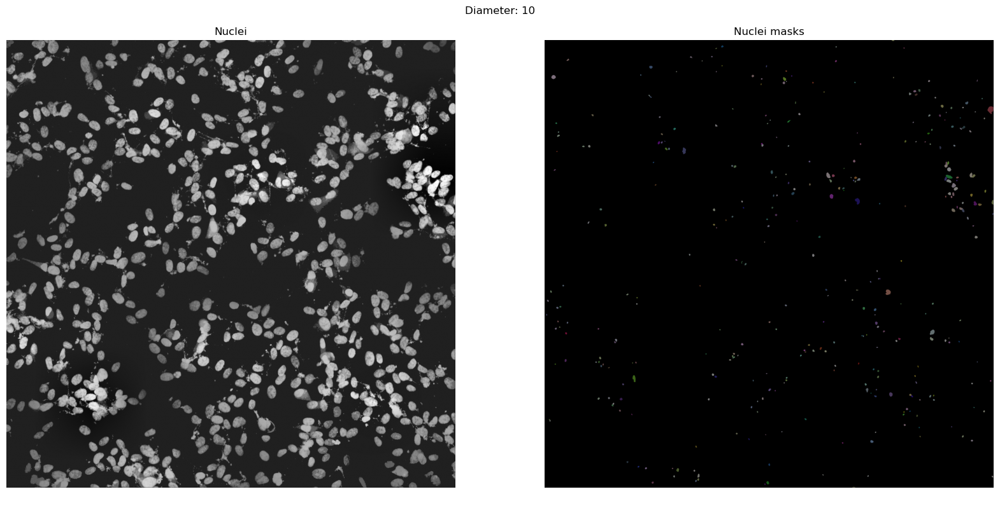

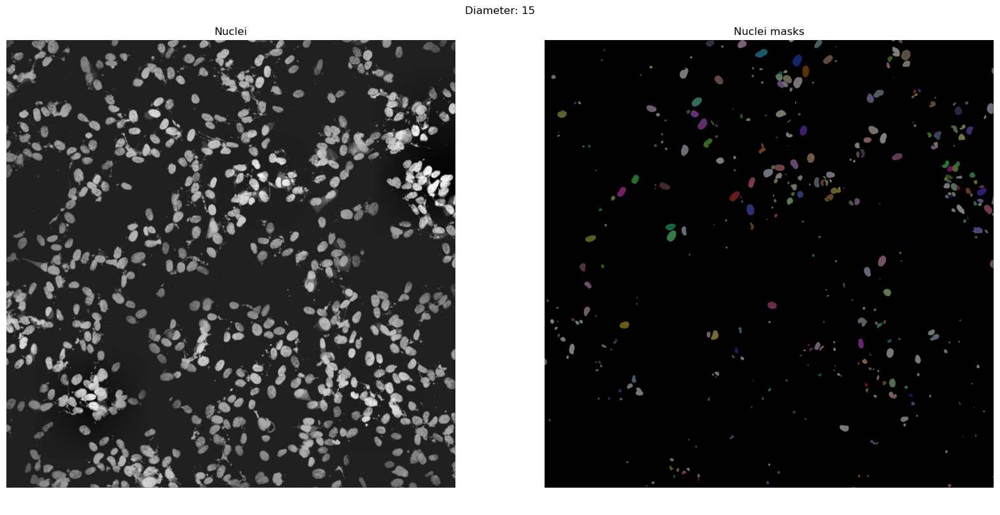

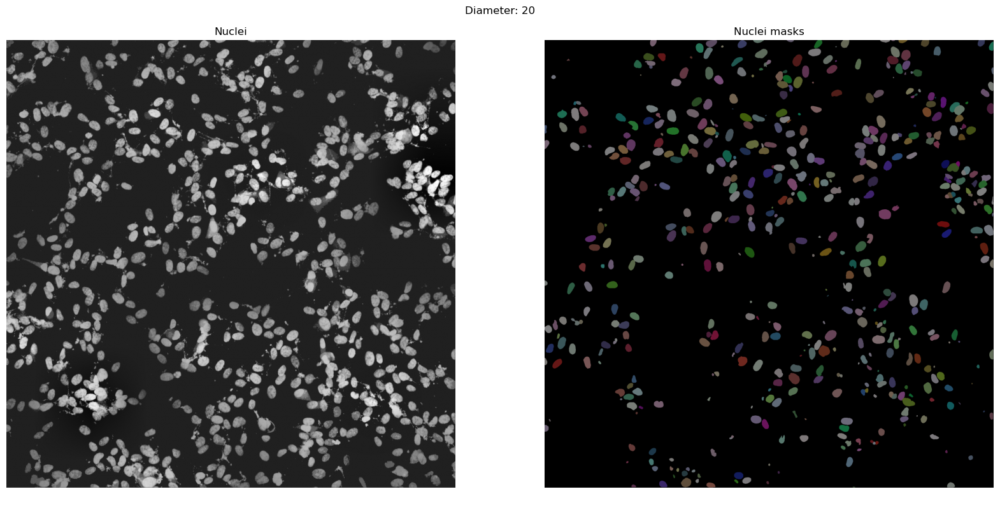

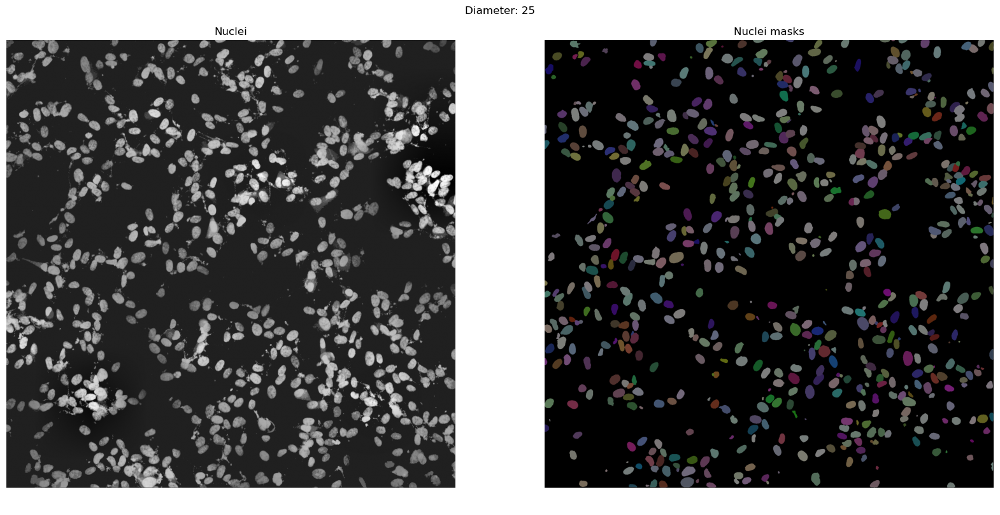

...

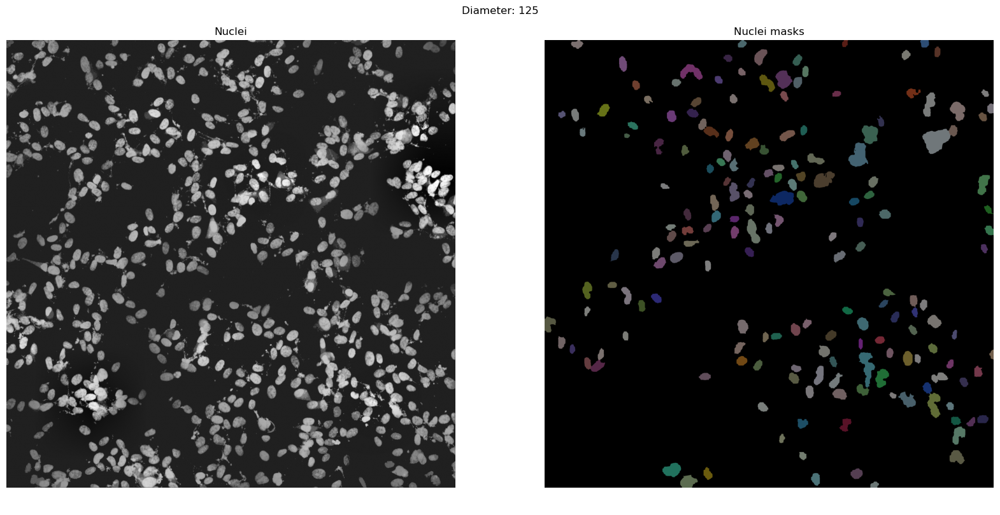

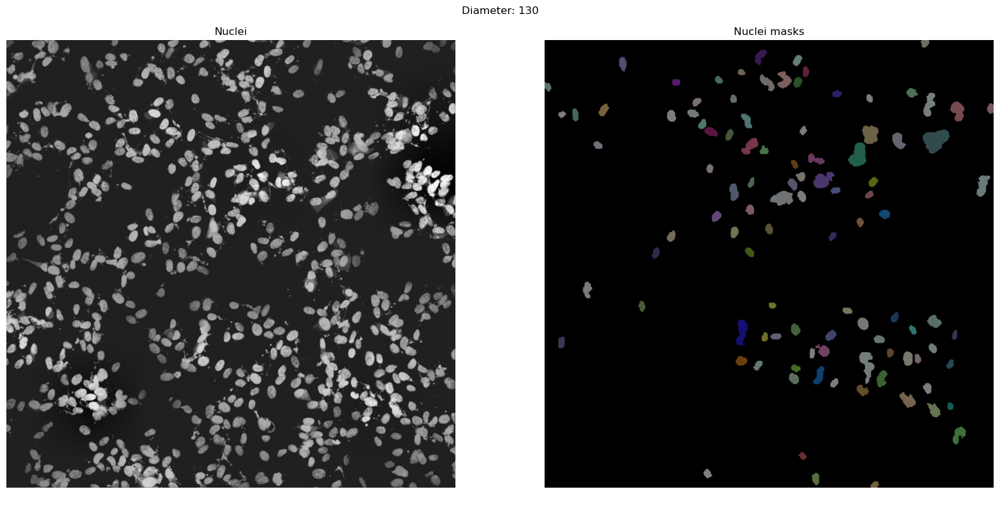

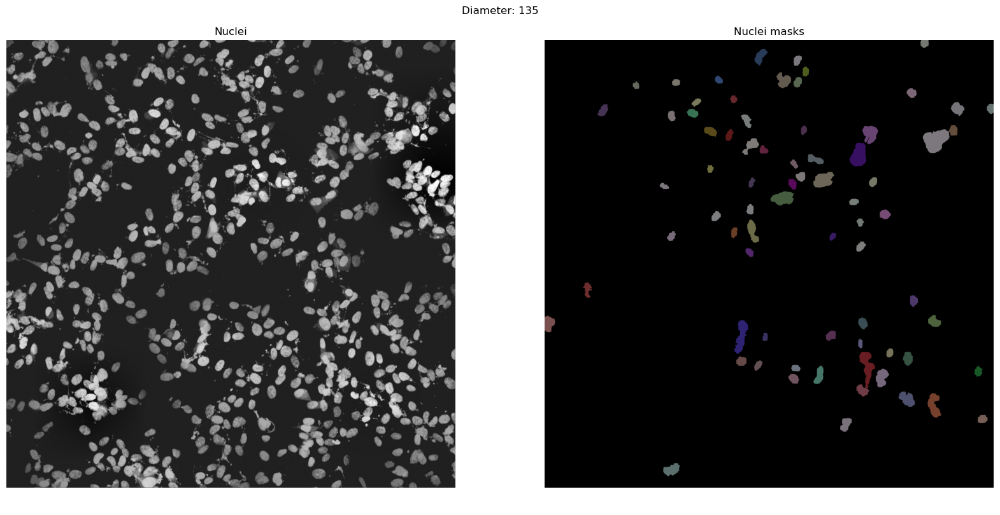

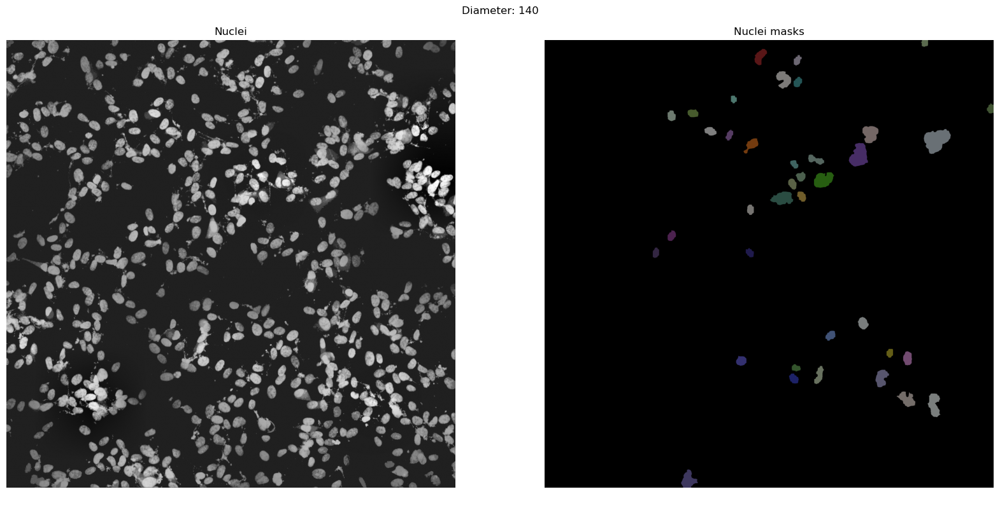

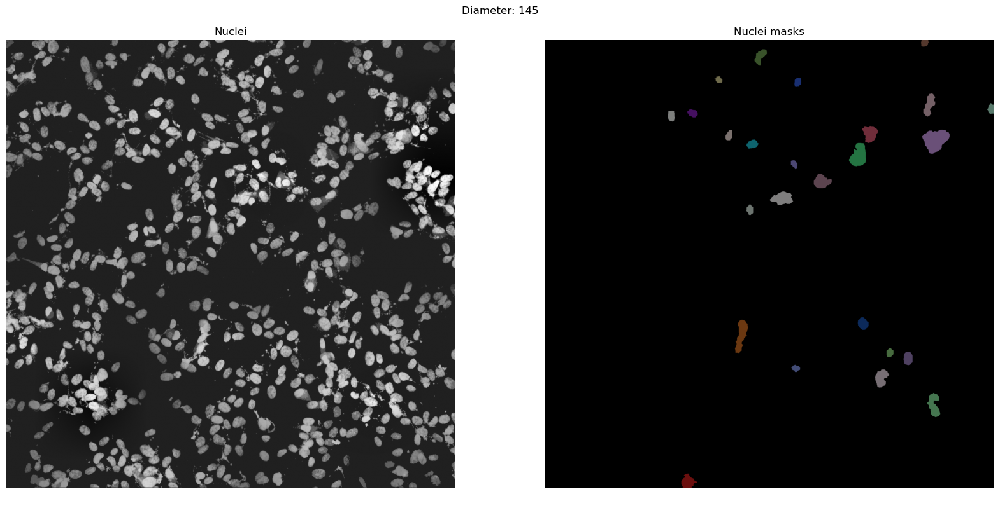

Best diameter:  35
Number of unique masks:  712


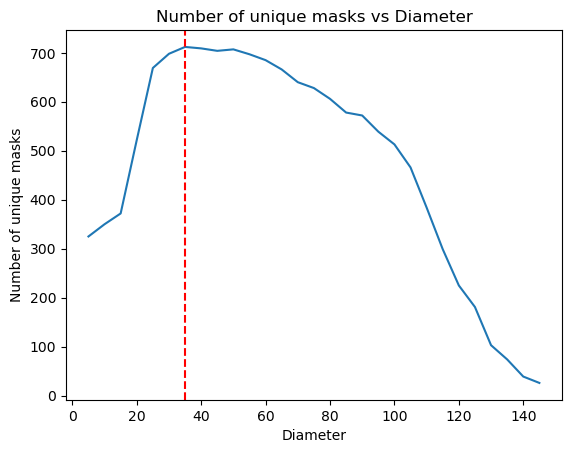

<Figure size 640x480 with 0 Axes>

In [8]:
if optimize_segmentation:
    # model_type='cyto' or 'nuclei' or 'cyto2' or 'cyto3'
    model_name = "nuclei"
    model = models.Cellpose(model_type=model_name, gpu=True)

    channels = [[1, 0]]

    masks_all_dict = {"masks": [], "imgs": [], "diameter": []}
    # get masks for all the images
    # save to a dict for later use
    img = nuclei[1, :, :]
    img = normalize(img)
    for diameter in range(5, 150, 5):
        masks, flows, styles, diams = model.eval(
            img, channels=channels, diameter=diameter
        )
        masks_all_dict["masks"].append(masks)
        masks_all_dict["imgs"].append(img)
        masks_all_dict["diameter"].append(diameter)
    print(len(masks_all_dict))
    masks_all = masks_all_dict["masks"]
    imgs = masks_all_dict["imgs"]
    diameters = masks_all_dict["diameter"]

    masks_all = np.array(masks_all)
    imgs = np.array(imgs)

    if in_notebook:
        for diameter in range(len(diameters)):
            plt.figure(figsize=(20, 10))
            plt.title(f"Diameter: {diameters[diameter]}")
            plt.axis("off")
            plt.subplot(1, 2, 1)
            plt.imshow(imgs[diameter], cmap="gray")
            plt.title("Nuclei")
            plt.axis("off")

            plt.subplot(122)
            plt.imshow(render_label(masks_all[diameter]))
            plt.title("Nuclei masks")
            plt.axis("off")
            plt.show()

    # get the number of unique masks for each diameter
    unique_masks_dict = {
        "diameter": [],
        "unique_masks": [],
    }
    for diameter in range(len(diameters)):
        unique_masks = np.unique(masks_all[diameter])
        unique_masks_dict["diameter"].append(diameters[diameter])
        unique_masks_dict["unique_masks"].append(len(unique_masks))

    # get the diameter that is for the max
    best_diameter = unique_masks_dict["diameter"][
        np.argmax(unique_masks_dict["unique_masks"])
    ]
    print("Best diameter: ", best_diameter)
    print("Number of unique masks: ", np.max(unique_masks_dict["unique_masks"]))

    plt.plot(unique_masks_dict["diameter"], unique_masks_dict["unique_masks"])
    # plot a vertical line
    plt.axvline(x=best_diameter, color="red", linestyle="--")
    plt.xlabel("Diameter")
    plt.ylabel("Number of unique masks")
    plt.title("Number of unique masks vs Diameter")
    if in_notebook:
        plt.show()
    plt.savefig("../figures/unique_nuclei_masks_vs_diameter.png")

### Runnning segmentation

In [9]:
if not optimize_segmentation:
    # model_type='cyto' or 'nuclei' or 'cyto2' or 'cyto3'
    model_name = "nuclei"
    model = models.Cellpose(model_type=model_name, gpu=True)

    channels = [[1, 0]]

    masks_all_dict = {"masks": [], "imgs": []}

    # get masks for all the images
    # save to a dict for later use
    for img in nuclei:
        img = normalize(img)
        masks, flows, styles, diams = model.eval(img, channels=channels, diameter=50)

        masks_all_dict["masks"].append(masks)
        masks_all_dict["imgs"].append(img)
    print(len(masks_all_dict))
    masks_all = masks_all_dict["masks"]
    imgs = masks_all_dict["imgs"]

    masks_all = np.array(masks_all)
    imgs = np.array(imgs)

    for frame_index, frame in enumerate(image_dict["nuclei_file_paths"]):
        # saving the masks
        print(
            f"Saing mask to {input_dir}/{str(frame).split('/')[-1].split('_C4')[0]}_nuclei_mask.tiff"
        )
        tifffile.imwrite(
            f"{input_dir}/{str(frame).split('/')[-1].split('_C4')[0]}_nuclei_mask.tiff",
            masks_all[frame_index, :, :],
        )
    if in_notebook:
        for z in range(len(masks_all)):
            plt.figure(figsize=(20, 10))
            plt.title(f"z: {z}")
            plt.axis("off")
            plt.subplot(1, 2, 1)
            plt.imshow(nuclei[z], cmap="gray")
            plt.title("Nuclei")
            plt.axis("off")

            plt.subplot(122)
            plt.imshow(render_label(masks_all[z]))
            plt.title("Cell masks")
            plt.axis("off")
            plt.show()

In [10]:
# set up memory profiler for GPU
device = torch.device("cuda:0")
free_after, total_after = torch.cuda.mem_get_info(device)
amount_used = ((total_after - free_after)) / 1024**2
print(f"Used: {amount_used} MB or {amount_used / 1024} GB of GPU RAM")

Used: 21392.0 MB or 20.890625 GB of GPU RAM
